#Installing Ultralytics


In [4]:
!pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.231 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 37.9/112.6 GB disk)


#Command Line Interface

In [5]:
#Using yolo pretrained models for prediction and visualize the predicted image fuction
import cv2
from google.colab.patches import cv2_imshow

def show_image(image_path):
  """fun to display image using OpenCV in colab"""
  image = cv2.imread(image_path)
  if image is None :
    print("Error : Image not found!")
    return
  cv2_imshow(image)


Ultralytics 8.3.231 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs

Found https://images.pexels.com/photos/13872248/pexels-photo-13872248.jpeg locally at pexels-photo-13872248.jpeg
image 1/1 /content/pexels-photo-13872248.jpeg: 448x640 6 persons, 48.3ms
Speed: 3.3ms preprocess, 48.3ms inference, 4.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


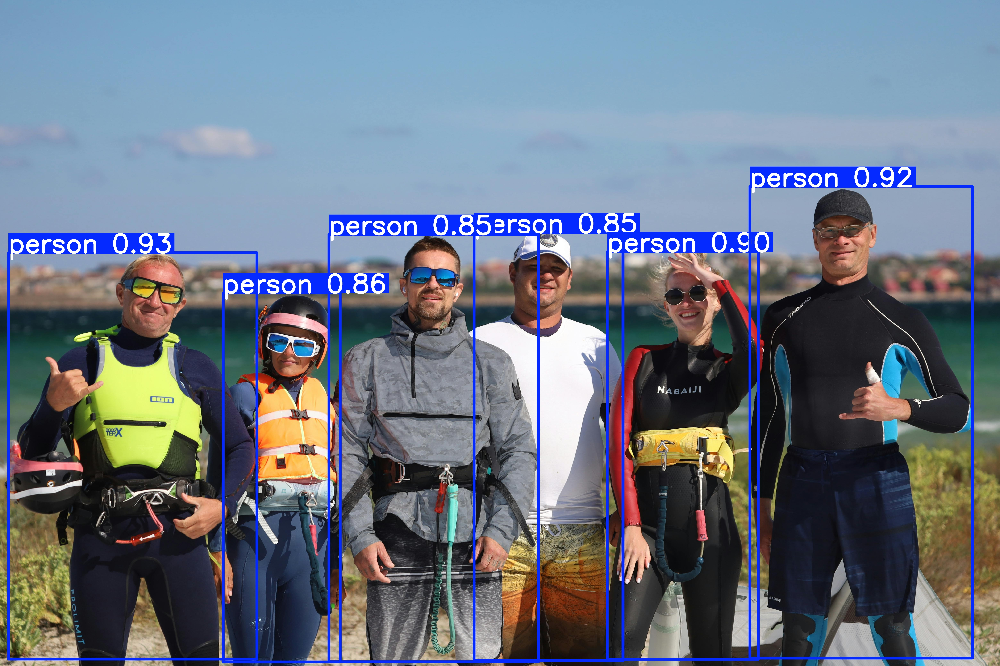

In [7]:
#Run inference on an image with yolo'n
!yolo predict model=yolo11n.pt source="https://images.pexels.com/photos/13872248/pexels-photo-13872248.jpeg"

show_image('/content/runs/detect/predict/pexels-photo-13872248.jpg')

#for python usage

In [8]:
from ultralytics import YOLO

In [10]:
#Load yolo model
model = YOLO("yolo11n.pt")

In [11]:
#predict with the mdoel
source="https://images.pexels.com/photos/13872248/pexels-photo-13872248.jpeg"
results = model(source)


Found https://images.pexels.com/photos/13872248/pexels-photo-13872248.jpeg locally at pexels-photo-13872248.jpeg
image 1/1 /content/pexels-photo-13872248.jpeg: 448x640 6 persons, 77.8ms
Speed: 4.4ms preprocess, 77.8ms inference, 6.3ms postprocess per image at shape (1, 3, 448, 640)


In [13]:
#Access the results
for i, result in enumerate(results):
  print(f'\n Result {i+1}:')
  xywh = result.boxes.xywh
  print("Bounding Boxes : ")
  print(xywh)

  xywhn = result.boxes.xywhn
  print("Normalized Bounding Boxes")
  print(xywhn)

  xyxy = result.boxes.xyxy
  print("Bounding Boxes")
  print(xyxy)

  xyxyn = result.boxes.xyxyn
  print("Normalized")
  print(xyxyn)

  names = [result.names[cls.item()] for cls in result.boxes.cls.int()]
  print("Class Names")
  print(names)

  confs = result.boxes.conf
  print("Confidence Scores : ")
  print(confs)


 Result 1:
Bounding Boxes : 
tensor([[ 828.8272, 2847.5269, 1550.1241, 2537.7021],
        [5373.4834, 2637.5203, 1388.1470, 2946.3579],
        [4260.4365, 2844.7700,  942.1907, 2547.0823],
        [1757.6855, 2981.9368,  729.5629, 2304.1606],
        [2706.1221, 2798.7856, 1308.1619, 2670.2979],
        [3422.8311, 2790.3442,  929.0369, 2673.0732]], device='cuda:0')
Normalized Bounding Boxes
tensor([[0.1328, 0.6845, 0.2484, 0.6100],
        [0.8611, 0.6340, 0.2225, 0.7083],
        [0.6828, 0.6838, 0.1510, 0.6123],
        [0.2817, 0.7168, 0.1169, 0.5539],
        [0.4337, 0.6728, 0.2096, 0.6419],
        [0.5485, 0.6708, 0.1489, 0.6426]], device='cuda:0')
Bounding Boxes
tensor([[  53.7651, 1578.6758, 1603.8893, 4116.3779],
        [4679.4102, 1164.3413, 6067.5571, 4110.6992],
        [3789.3411, 1571.2288, 4731.5317, 4118.3110],
        [1392.9042, 1829.8564, 2122.4670, 4134.0171],
        [2052.0413, 1463.6366, 3360.2031, 4133.9346],
        [2958.3127, 1453.8075, 3887.3496, 4126.

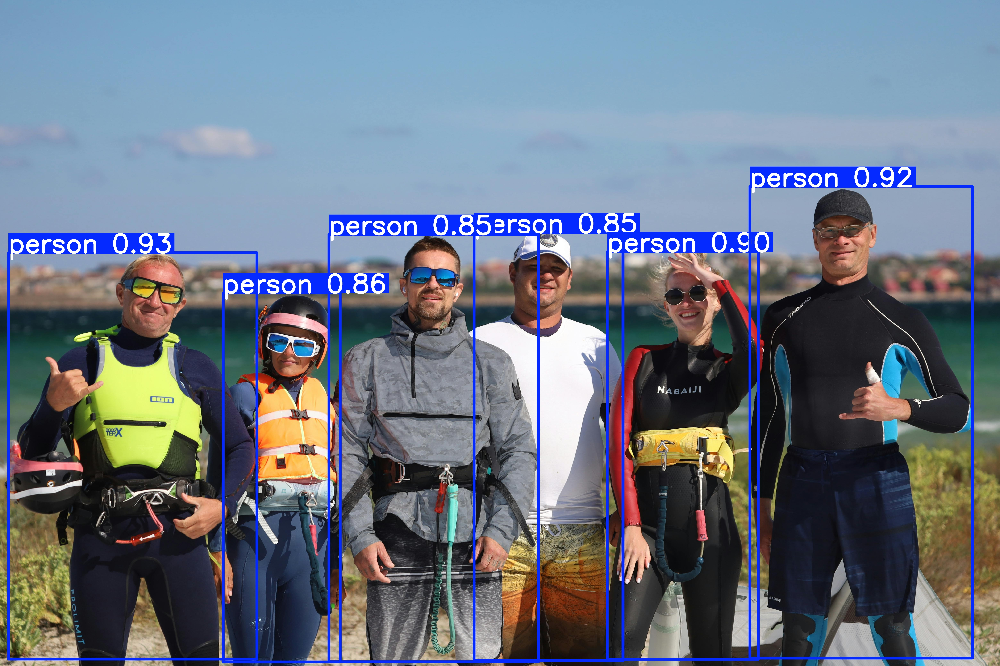

In [20]:
output_path = "/content/runs/detect/predict2/pexels-photo-13872248.jpg"

show_image(output_path)